# Compare Simulated Contact Map with Experimental Hi-C

Hi-C contact maps are provided by Rao et al. (2014) at GEO accession GSE63525.

### Import Modules

In [1]:
import os
import sys
import json

import skimage
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

### Specify Contact Maps

In [2]:
ref_cmap_path = "/scratch/users/jwakim/chromo_two_mark_phase_transition/output/Rao_data/chr_16_log_contacts.csv"
output_dir = "/scratch/users/jwakim/chromo_two_mark_phase_transition/output"
sim_cmap_file_name = "log_detailed_contact_map.csv"
binder_filename = "binders"
sim_ids = np.arange(32) + 1 + 32

sims = [f"sim_{sim_id}" for sim_id in sim_ids]
sim_cmap_paths = [f"{output_dir}/{sim}/{sim_cmap_file_name}" for sim in sims]

# Parameter settings
cross_levels = (0.25, 0.5)
cp_HP1_levels = (-0.5, -0.3)
cp_PRC1_levels = (-0.5, -0.3)
HP1_self_levels = (-4.5, -4.0)
PRC1_self_levels = (-4.5, -4.0)

### Load Reference Contact Map

In [3]:
ref_cmap = pd.read_csv(ref_cmap_path, header=None).to_numpy()

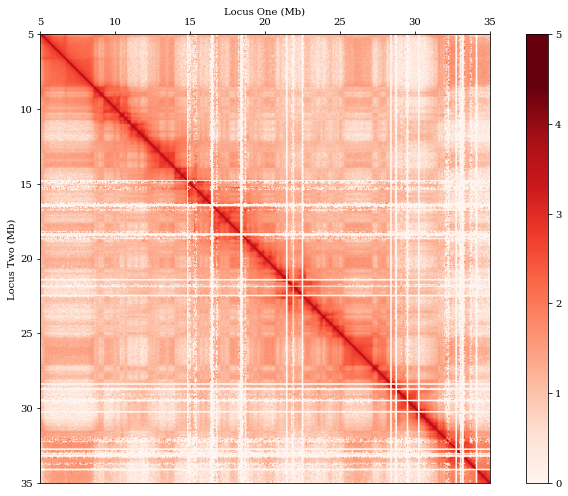

In [4]:
font = {'family' : 'serif',
        'weight':'normal',
        'size': 24}
plt.rc('font', **font)

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.5)
extents = [5, 35, 35, 5]
im = ax.imshow(ref_cmap, cmap="Reds", extent=extents)
ax.set_xticks([5, 10, 15, 20, 25, 30, 35])
ax.set_yticks([5, 10, 15, 20, 25, 30, 35])
ticks = np.arange(np.ceil(np.max(ref_cmap))+1)
boundaries = np.linspace(0, np.ceil(np.max(ref_cmap)), 1000)
ax.set_xlabel("Locus One (Mb)")
ax.set_ylabel("Locus Two (Mb)")
ax.xaxis.set_label_position("top")
ax.xaxis.tick_top()
fig.colorbar(im, cax=cax, orientation='vertical', ticks=ticks, boundaries=boundaries)
plt.tight_layout()
plt.show()

### Load Simulated Contact Map

In [5]:
sim_cmaps = {}
for i, sim_path in enumerate(sim_cmap_paths):
    print(f"Loading Contact Map: {sims[i]}")
    sim_cmap = pd.read_csv(sim_path, header=None, sep=" ").to_numpy()
    sim_cmaps[sims[i]] = sim_cmap

Loading Contact Map: sim_33
Loading Contact Map: sim_34
Loading Contact Map: sim_35
Loading Contact Map: sim_36
Loading Contact Map: sim_37
Loading Contact Map: sim_38
Loading Contact Map: sim_39
Loading Contact Map: sim_40
Loading Contact Map: sim_41
Loading Contact Map: sim_42
Loading Contact Map: sim_43
Loading Contact Map: sim_44
Loading Contact Map: sim_45
Loading Contact Map: sim_46
Loading Contact Map: sim_47
Loading Contact Map: sim_48
Loading Contact Map: sim_49
Loading Contact Map: sim_50
Loading Contact Map: sim_51
Loading Contact Map: sim_52
Loading Contact Map: sim_53
Loading Contact Map: sim_54
Loading Contact Map: sim_55
Loading Contact Map: sim_56
Loading Contact Map: sim_57
Loading Contact Map: sim_58
Loading Contact Map: sim_59
Loading Contact Map: sim_60
Loading Contact Map: sim_61
Loading Contact Map: sim_62
Loading Contact Map: sim_63
Loading Contact Map: sim_64


### Isolate Genomic Region of Interest

Isolate genomic region between 5 Mb and 35 Mb for comparison. Assume chromosome 16 is 90 Mb large and that nucleosomes are evenly spaced. We are interested in nucleosome indices between (5/90) and (35/90) of the maximum nucleosome position. 

In [6]:
for i, sim in enumerate(sims):
    max_ind = len(sim_cmaps[sim]) - 1
    lower_bound = int(round((5 / 90) * max_ind))
    upper_bound = int(round((35 / 90) * max_ind))
    sim_cmaps[sim] = sim_cmaps[sim][lower_bound:upper_bound, lower_bound:upper_bound]

### Rescale Simulated Contact Maps to Match Experimental Hi-C

A common shape between experimental and simulated contact maps allows for direct evaluation of structural correlation.

In [7]:
sim_cmaps_rescaled = {}
ref_cmaps_rescaled = {}
for i, sim in enumerate(sims):
    if ref_cmap.shape[0] < sim_cmaps[sim].shape[0]:    
        sim_cmaps_rescaled[sim] = skimage.transform.resize(
            sim_cmaps[sim], (ref_cmap.shape[0], ref_cmap.shape[1]), anti_aliasing=True
        )
        ref_cmaps_rescaled[sim] = ref_cmap.copy()
    else:
        sim_cmaps_rescaled[sim] = sim_cmaps[sim].copy()
        ref_cmaps_rescaled[sim] = skimage.transform.resize(
            ref_cmap, (sim_cmaps[sim].shape[0], sim_cmaps[sim].shape[1]), anti_aliasing=True
        )

### Plot Rescaled Simulated Contact Maps

Simulation: sim_33


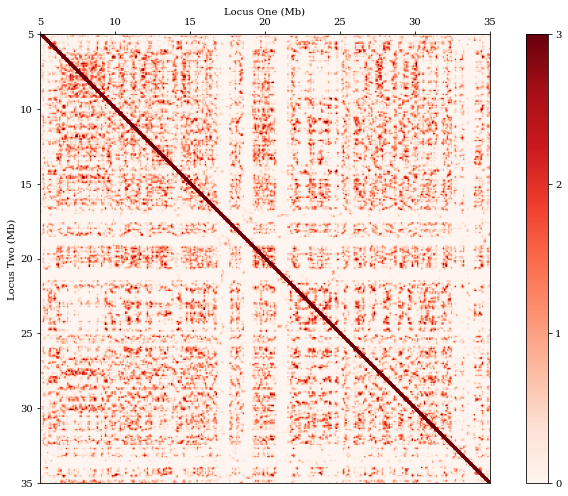



Simulation: sim_34


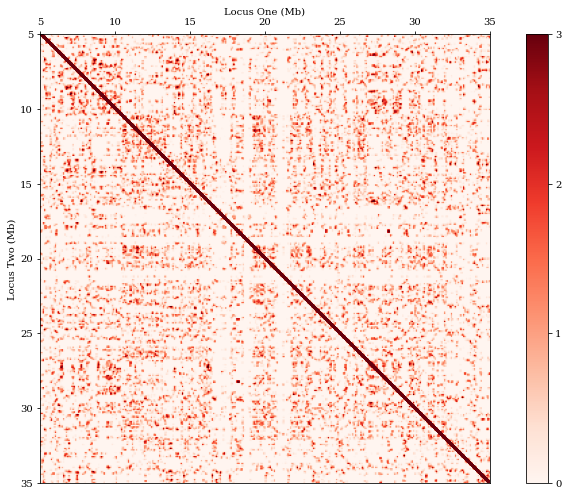



Simulation: sim_35


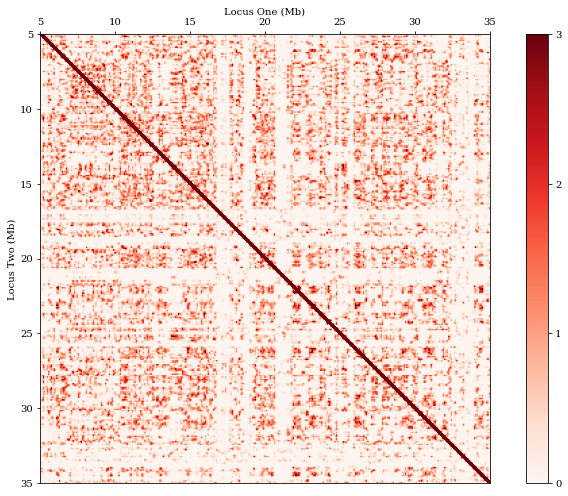



Simulation: sim_36


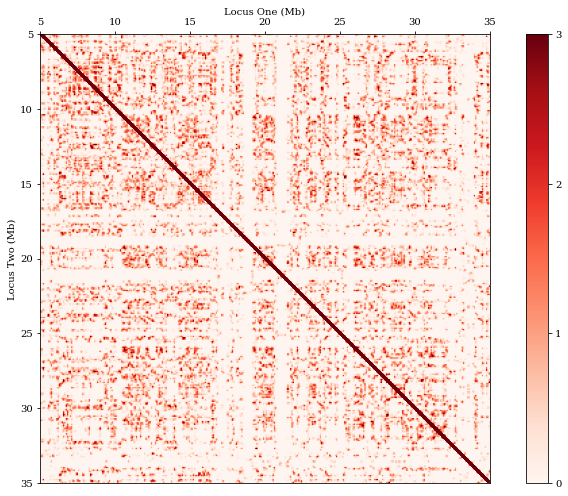



Simulation: sim_37


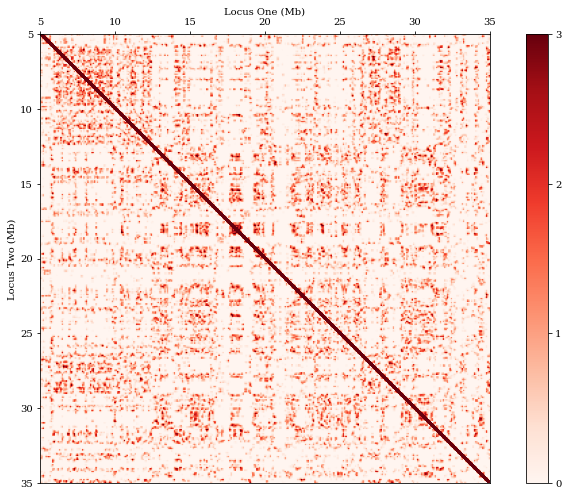



Simulation: sim_38


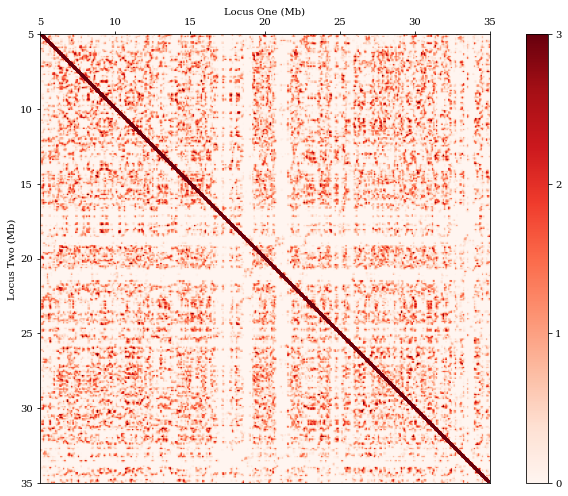



Simulation: sim_39


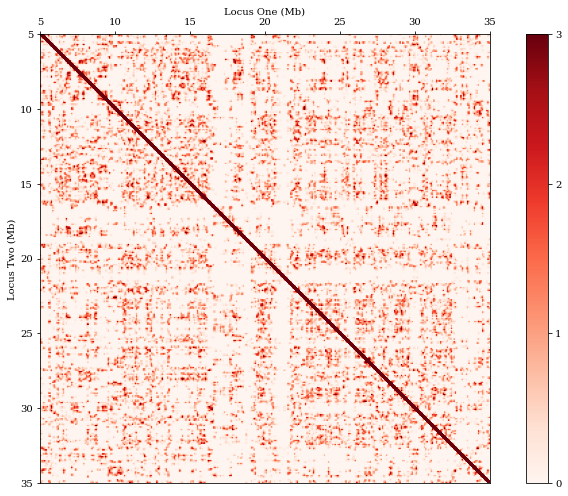



Simulation: sim_40


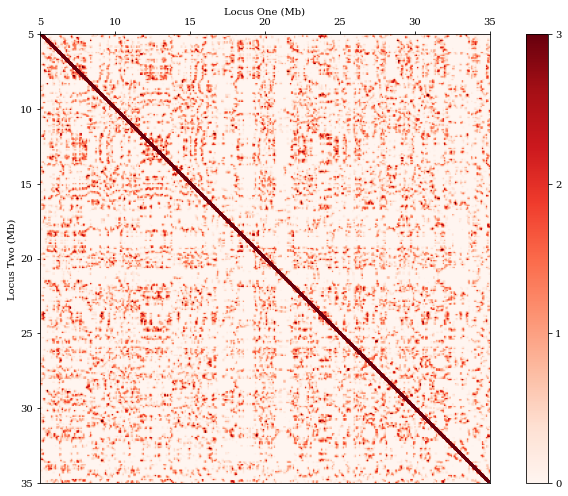



Simulation: sim_41


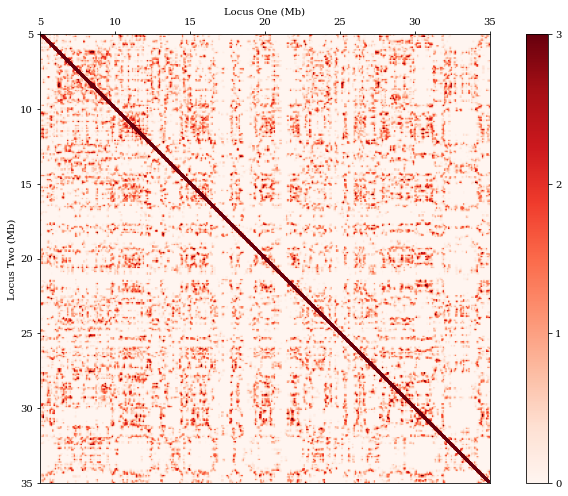



Simulation: sim_42


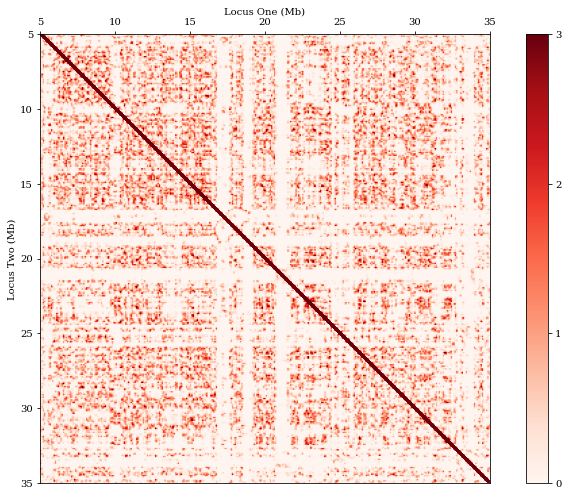



Simulation: sim_43


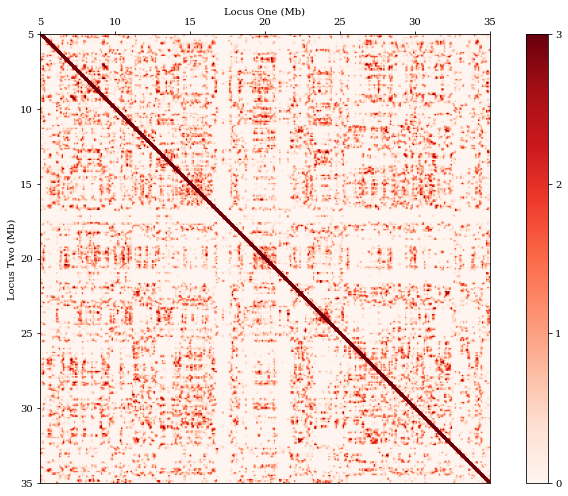



Simulation: sim_44


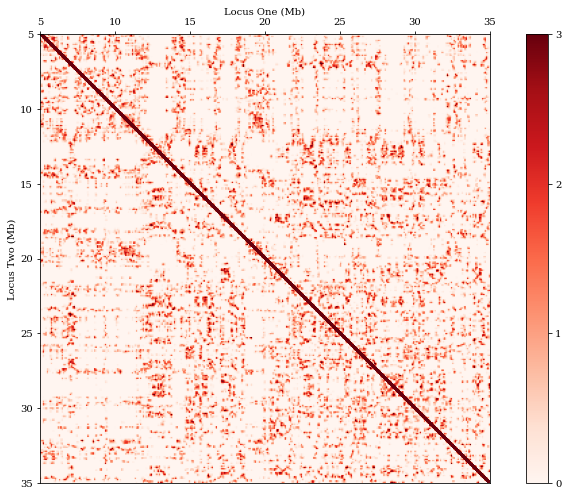



Simulation: sim_45


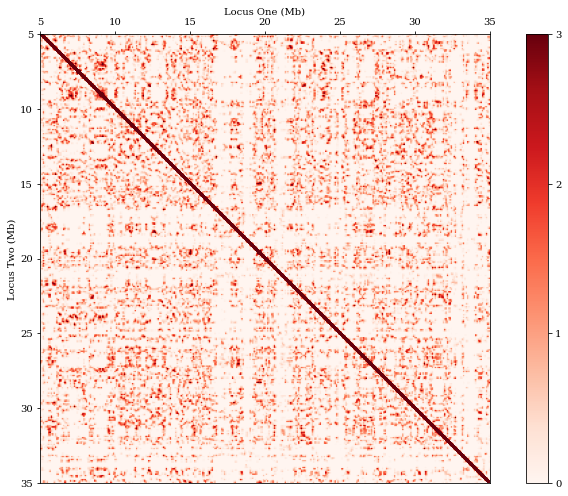



Simulation: sim_46


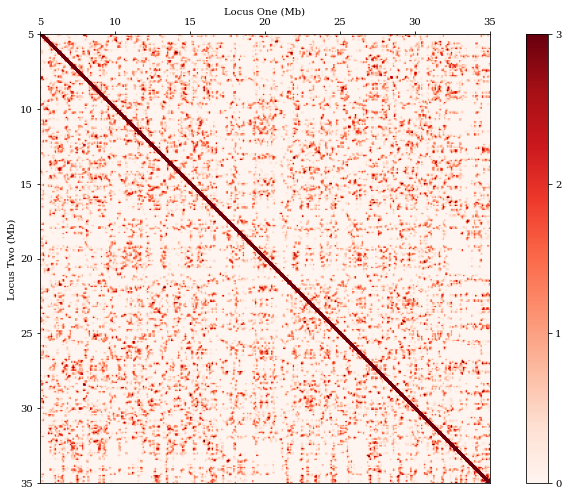



Simulation: sim_47


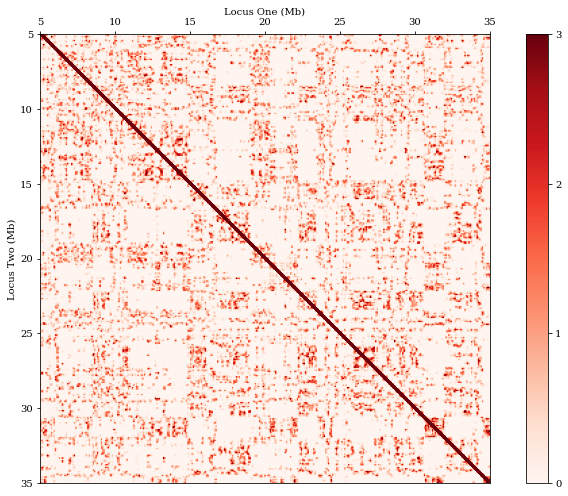



Simulation: sim_48


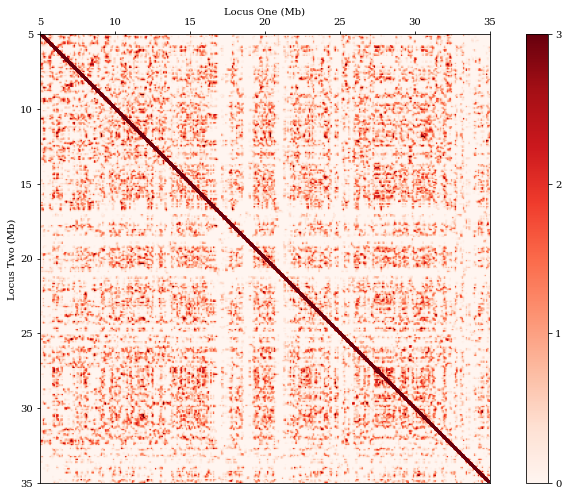



Simulation: sim_49


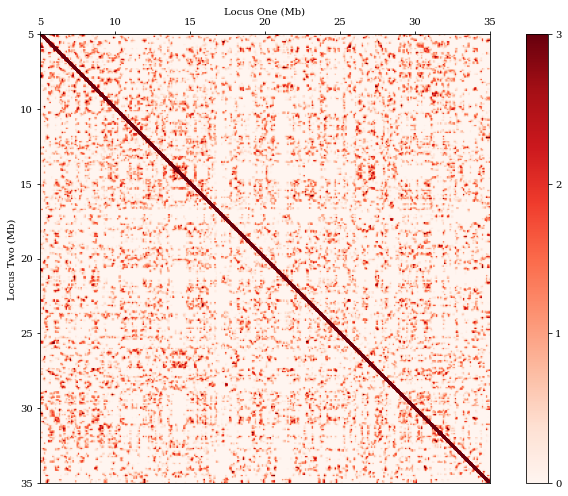



Simulation: sim_50


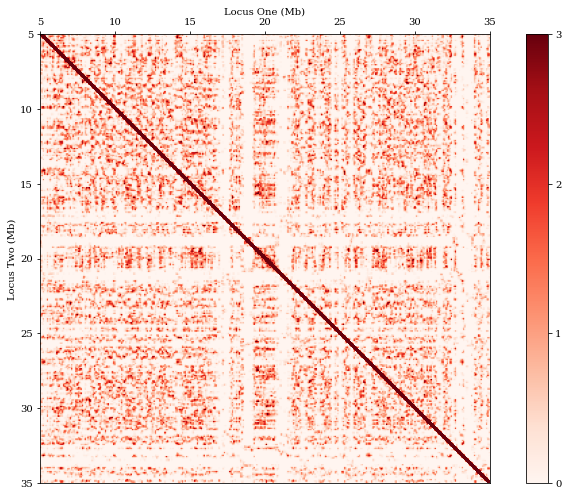



Simulation: sim_51


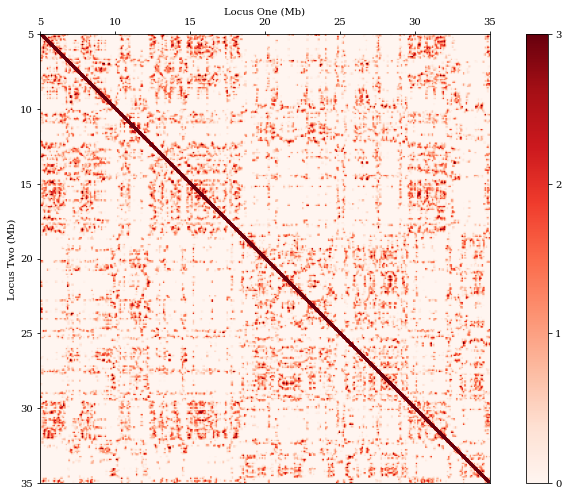



Simulation: sim_52


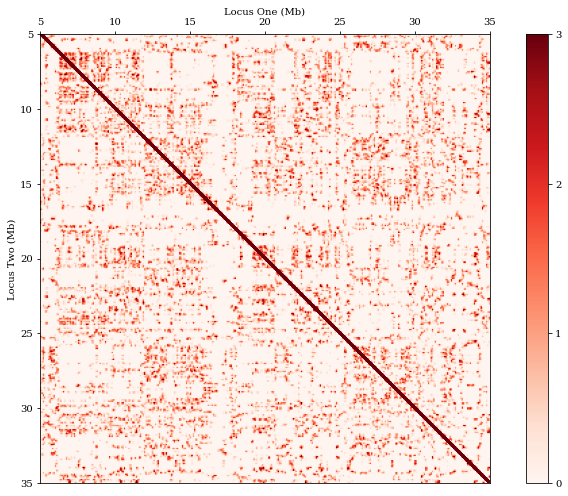



Simulation: sim_53


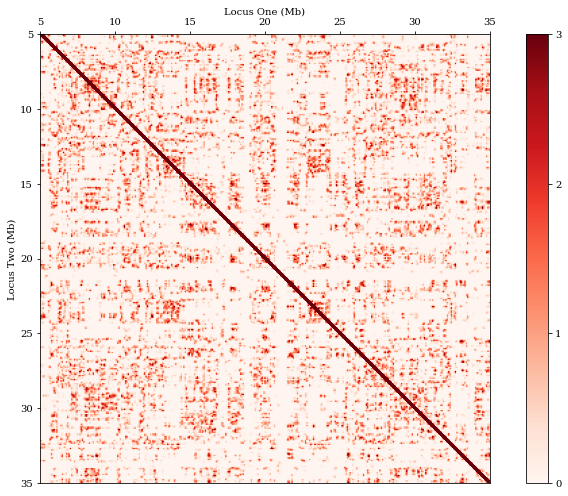



Simulation: sim_54


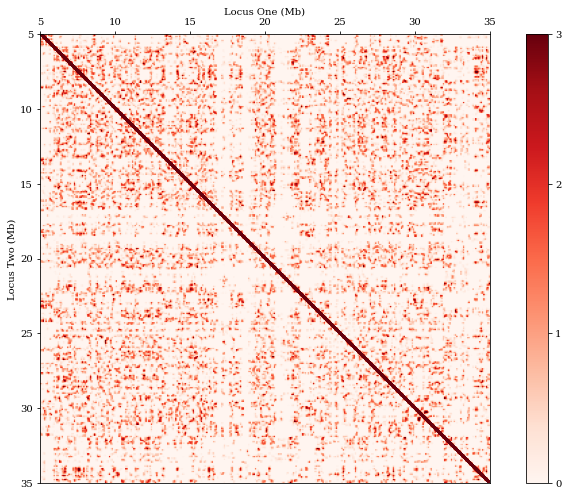



Simulation: sim_55


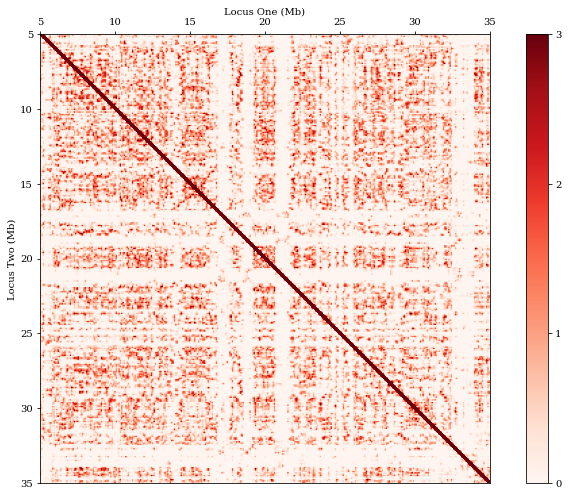



Simulation: sim_56


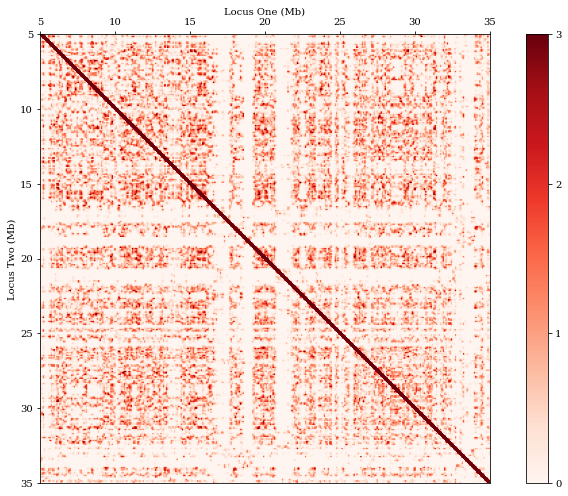



Simulation: sim_57


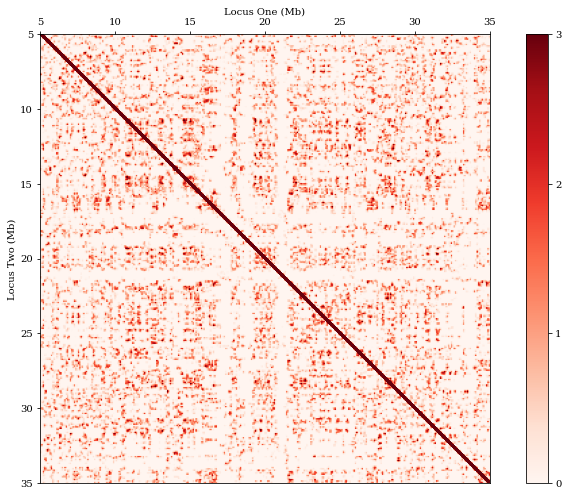



Simulation: sim_58


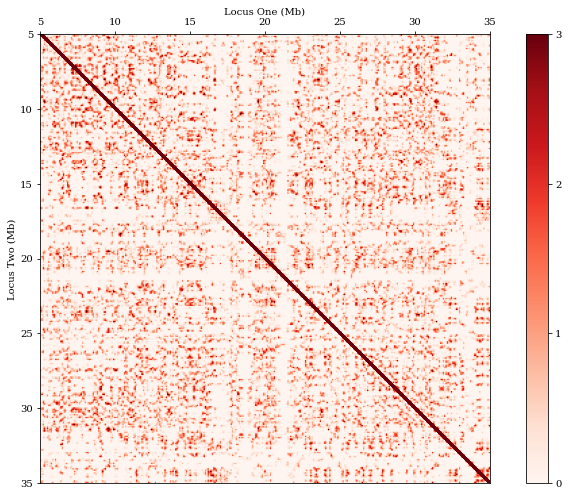



Simulation: sim_59


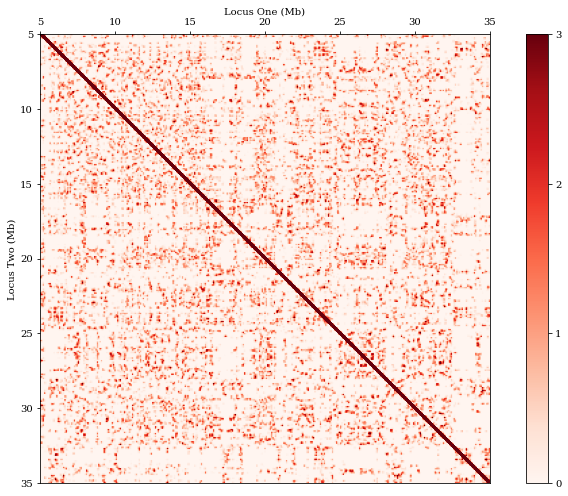



Simulation: sim_60


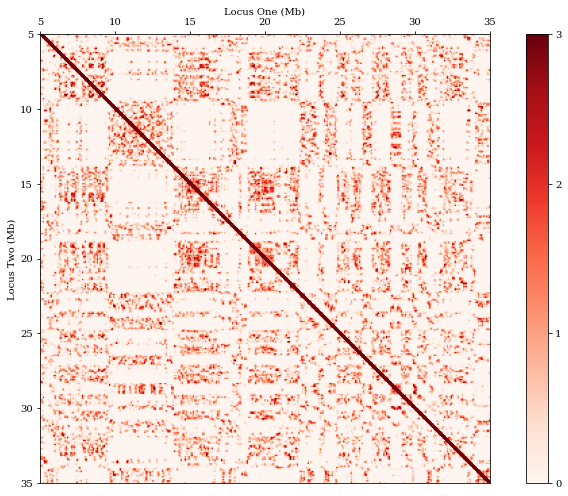



Simulation: sim_61


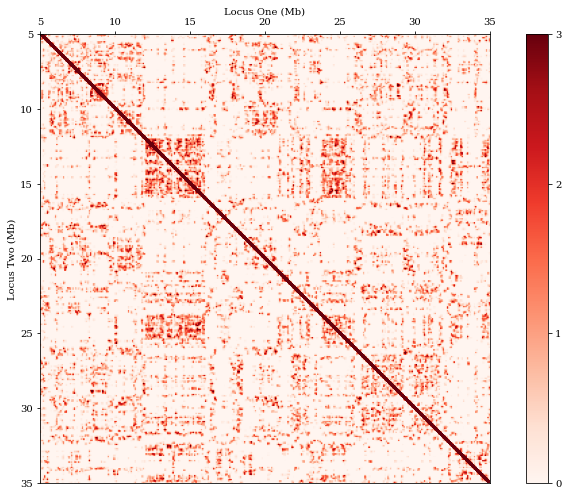



Simulation: sim_62


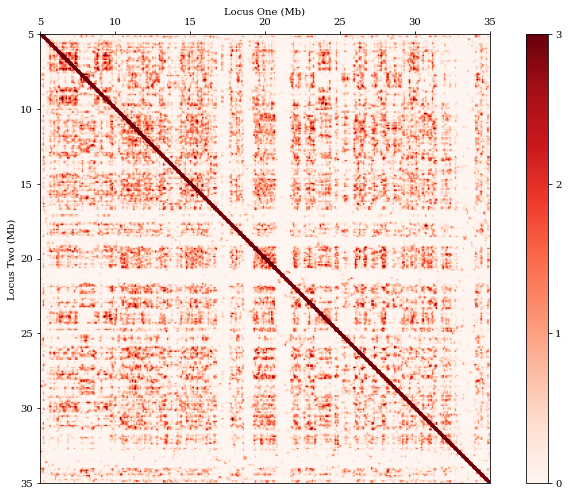



Simulation: sim_63


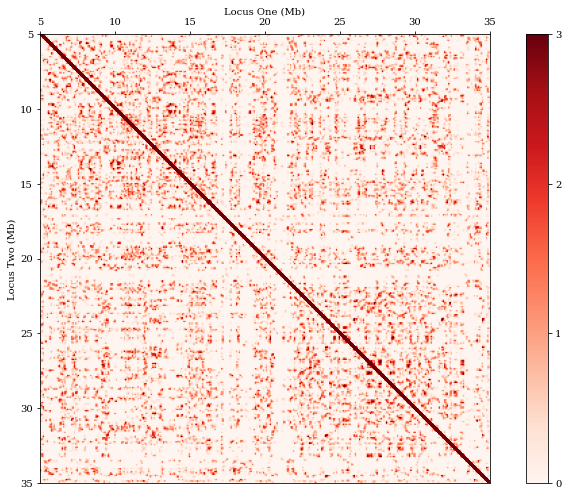



Simulation: sim_64


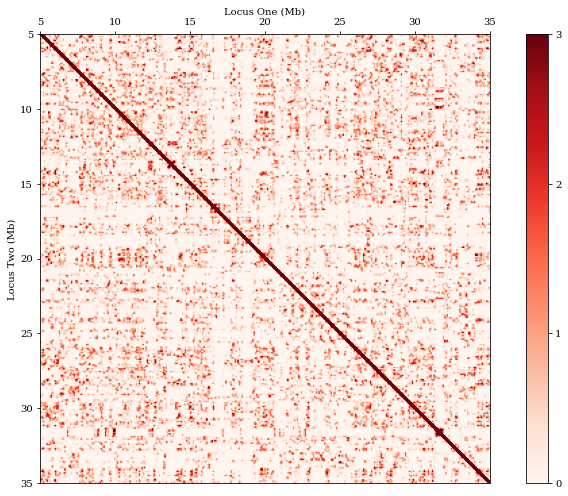

In [8]:
# Define a common colorbar
max_intensity = 0
for sim in sims:
    max_intensity_sim = np.ceil(np.max(sim_cmaps_rescaled[sim]))
    if max_intensity_sim > max_intensity:
        max_intensity = max_intensity_sim
        
# Normalize the maximum intensity
for sim in sims:
    sim_cmaps_rescaled[sim] *= max_intensity / np.max(sim_cmaps_rescaled[sim])
    ref_cmaps_rescaled[sim] *= max_intensity / np.max(ref_cmaps_rescaled[sim])
    
# Adjust the heat map intensity range for better visualization
max_scale = max_intensity_sim
for sim in sims:
    upper_percentile_signals = np.percentile(sim_cmaps_rescaled[sim], 99)
    sim_cmaps_rescaled[sim] *= max_scale / upper_percentile_signals
    
    upper_percentile_signals = np.percentile(ref_cmaps_rescaled[sim], 99)
    ref_cmaps_rescaled[sim] *= max_scale / upper_percentile_signals

# Create simulated contact maps
for i, sim in enumerate(sims):
    print(f"Simulation: {sim}")
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.5)
    extents = [5, 35, 35, 5]
    im = ax.imshow(sim_cmaps_rescaled[sim], cmap="Reds", extent=extents, vmin=0, vmax=max_scale)
    ax.set_xticks([5, 10, 15, 20, 25, 30, 35])
    ax.set_yticks([5, 10, 15, 20, 25, 30, 35])
    ticks = np.arange(max_scale+1)
    boundaries = np.linspace(0, max_scale, 1000)
    ax.set_xlabel("Locus One (Mb)")
    ax.set_ylabel("Locus Two (Mb)")
    ax.xaxis.set_label_position("top")
    ax.xaxis.tick_top()
    fig.colorbar(im, cax=cax, orientation='vertical', ticks=ticks, boundaries=boundaries)
    plt.tight_layout()
    plt.show()
    print("\n")

### Correlated Experimental and Simulated Contact Maps

Simulation: sim_33


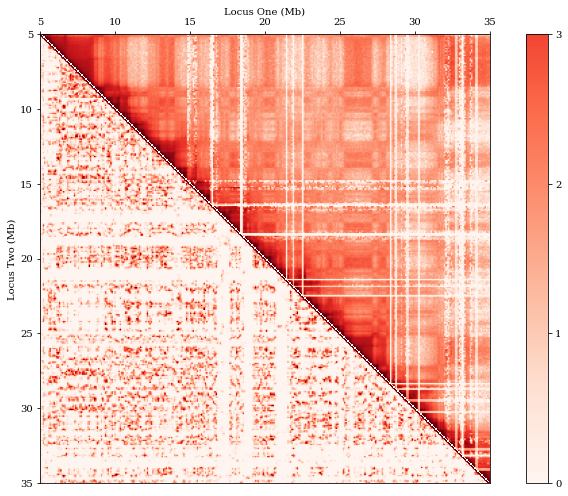

Correlation Coefficient: 0.313



Simulation: sim_34


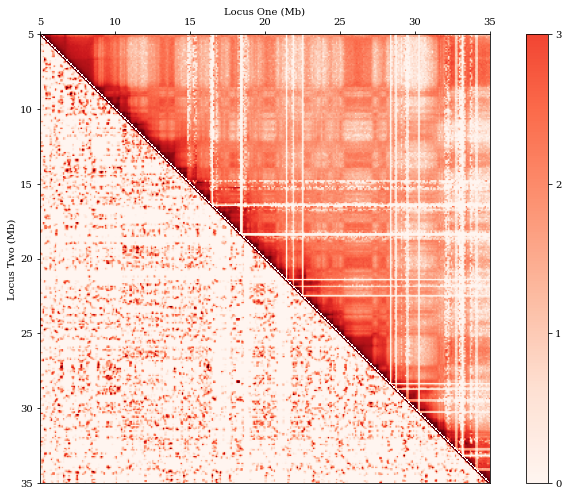

Correlation Coefficient: 0.3



Simulation: sim_35


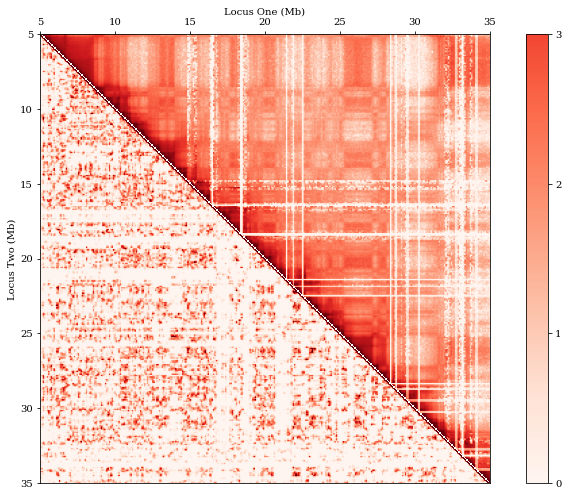

Correlation Coefficient: 0.312



Simulation: sim_36


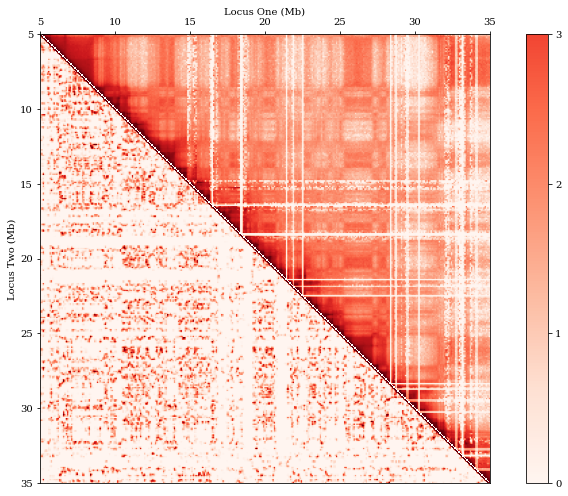

Correlation Coefficient: 0.31



Simulation: sim_37


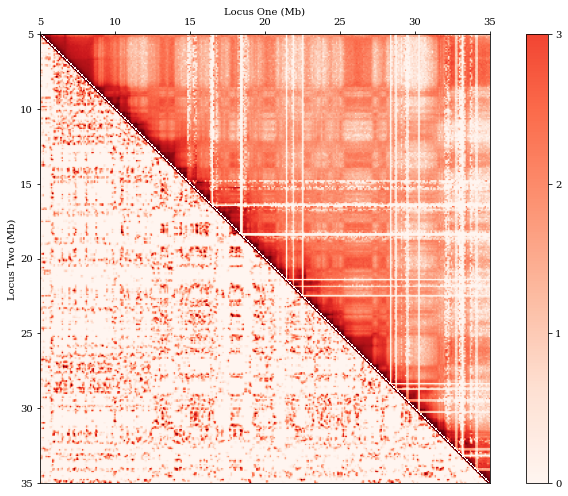

Correlation Coefficient: 0.308



Simulation: sim_38


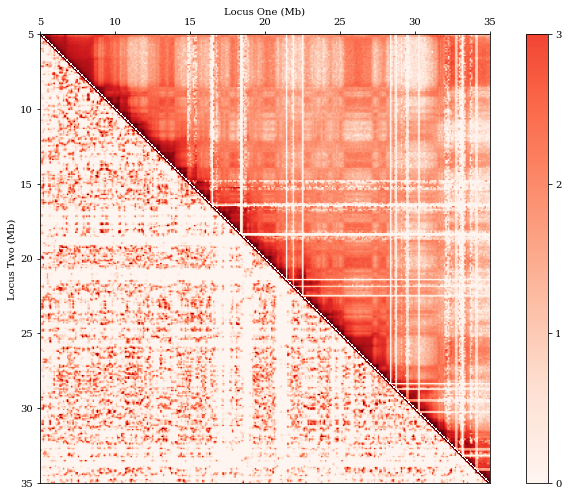

Correlation Coefficient: 0.305



Simulation: sim_39


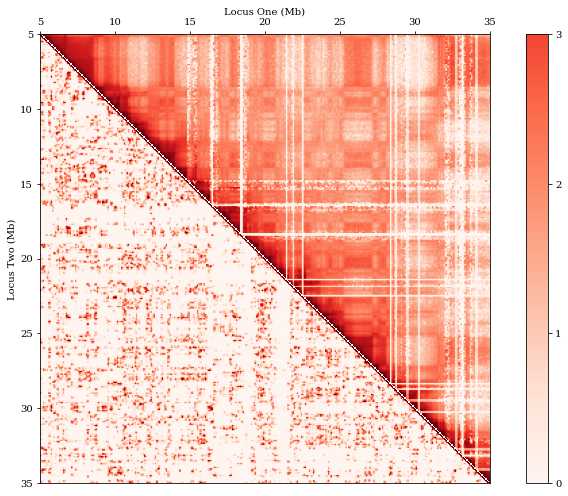

Correlation Coefficient: 0.307



Simulation: sim_40


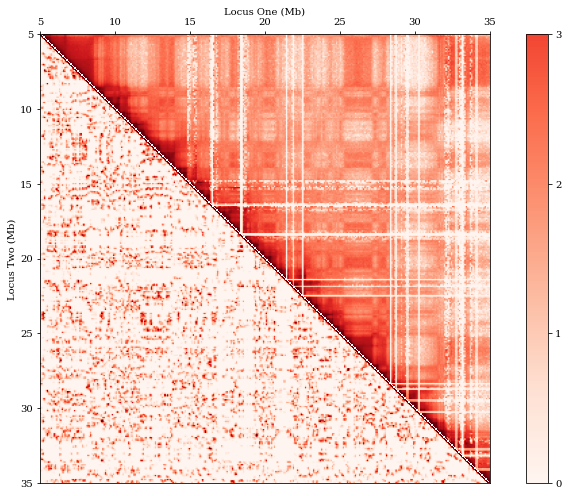

Correlation Coefficient: 0.297



Simulation: sim_41


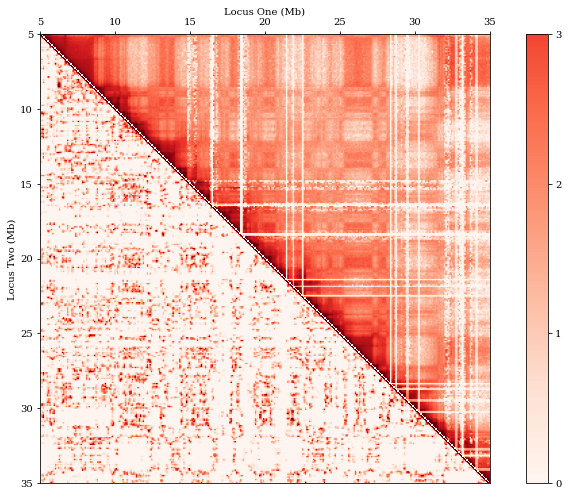

Correlation Coefficient: 0.298



Simulation: sim_42


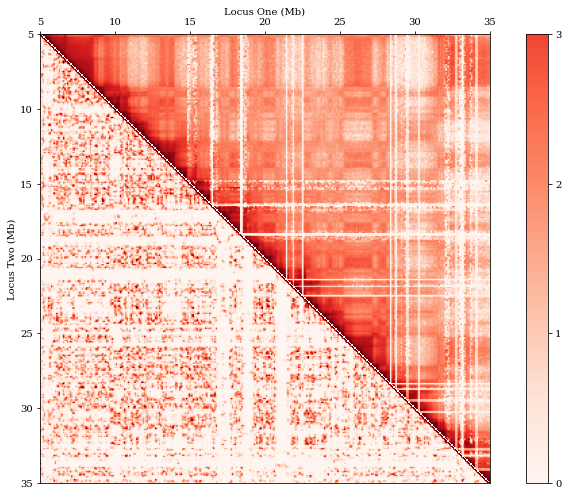

Correlation Coefficient: 0.314



Simulation: sim_43


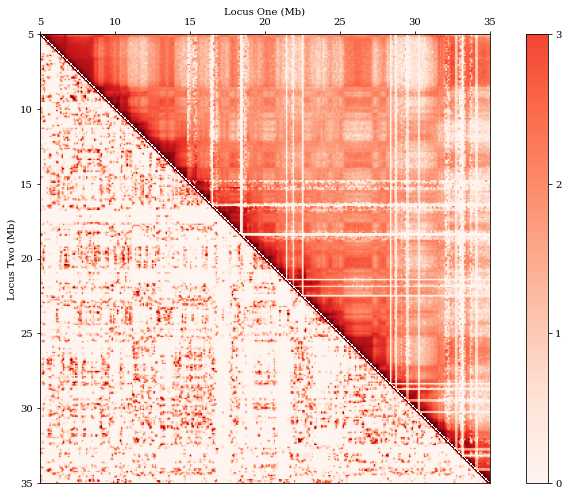

Correlation Coefficient: 0.298



Simulation: sim_44


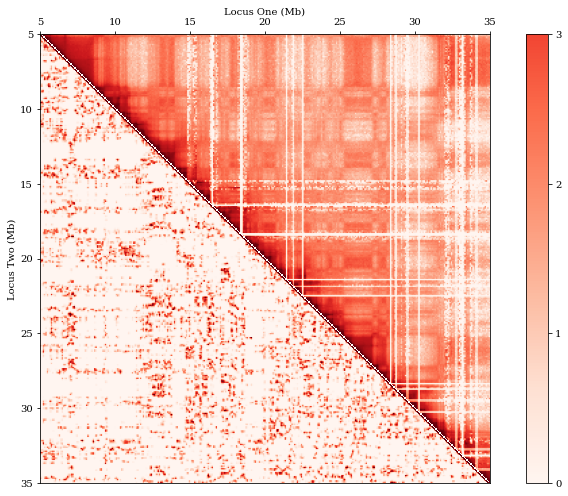

Correlation Coefficient: 0.296



Simulation: sim_45


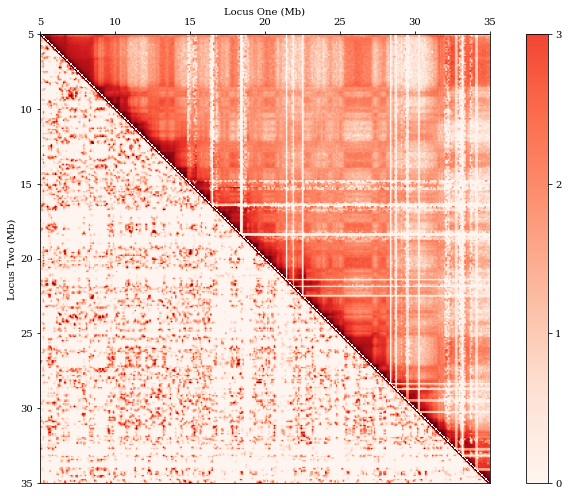

Correlation Coefficient: 0.301



Simulation: sim_46


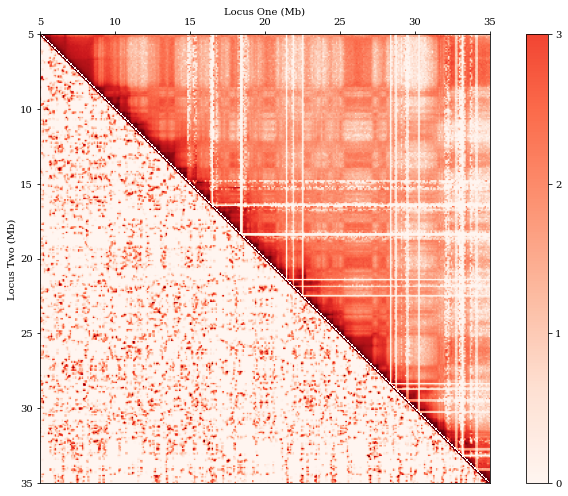

Correlation Coefficient: 0.293



Simulation: sim_47


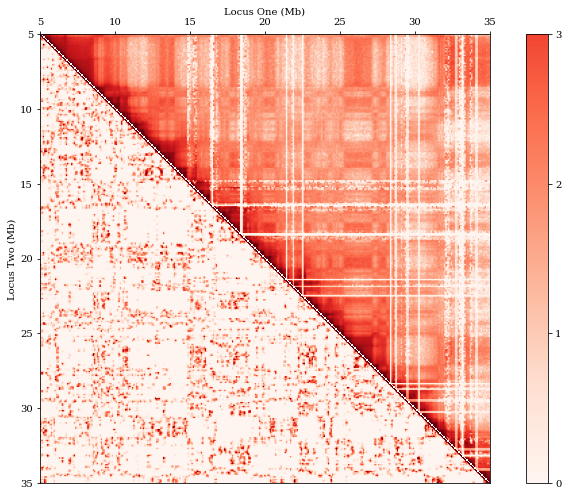

Correlation Coefficient: 0.293



Simulation: sim_48


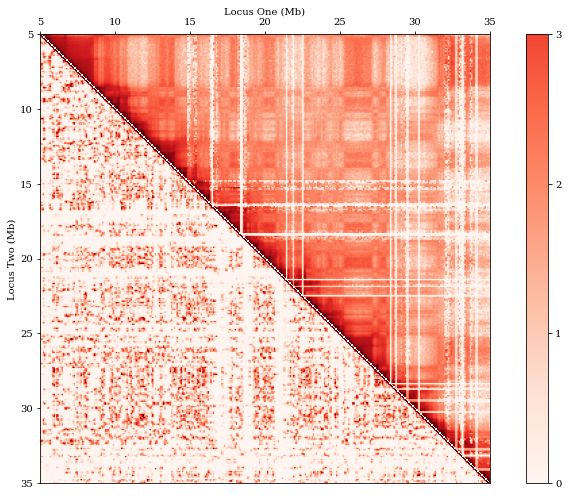

Correlation Coefficient: 0.313



Simulation: sim_49


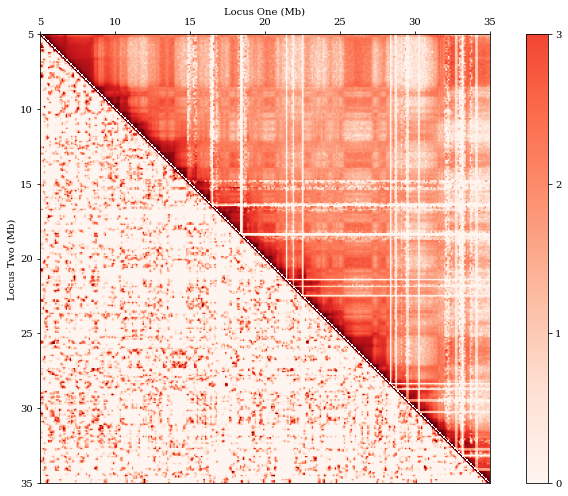

Correlation Coefficient: 0.298



Simulation: sim_50


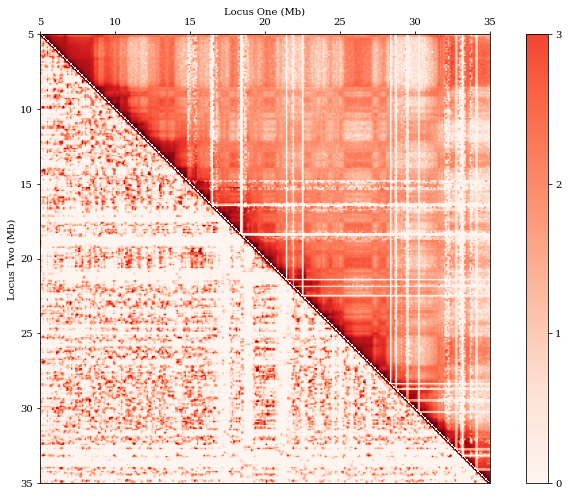

Correlation Coefficient: 0.311



Simulation: sim_51


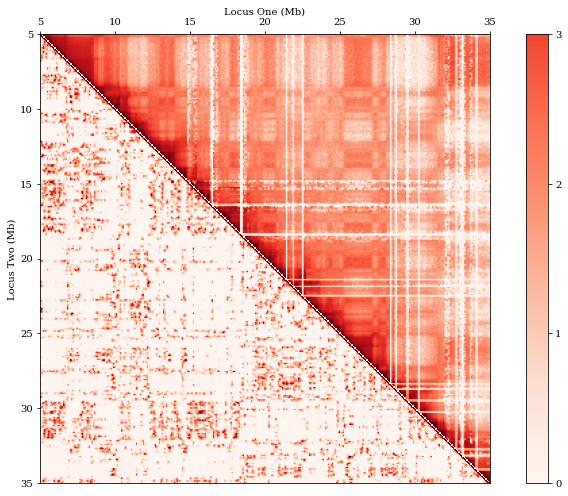

Correlation Coefficient: 0.305



Simulation: sim_52


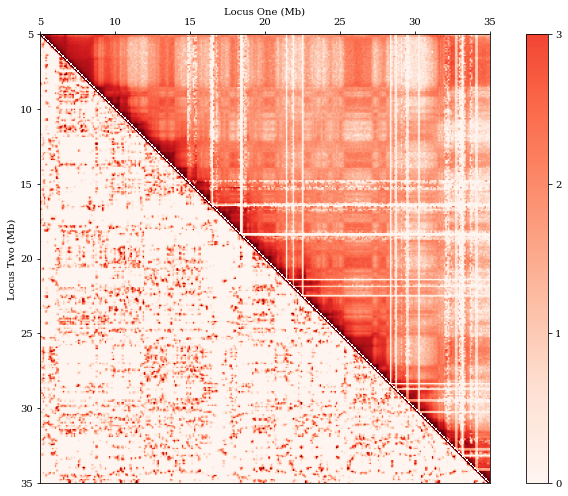

Correlation Coefficient: 0.3



Simulation: sim_53


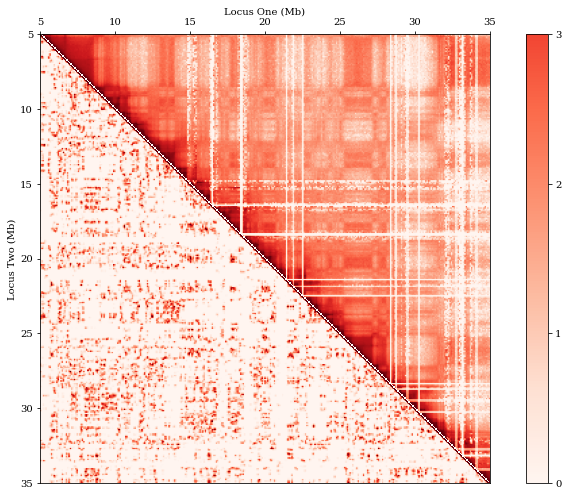

Correlation Coefficient: 0.3



Simulation: sim_54


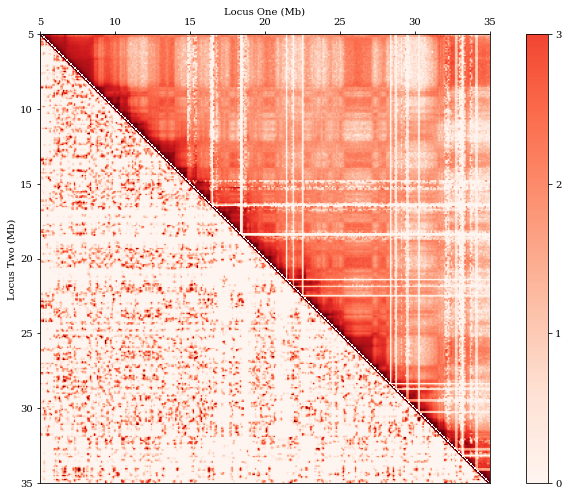

Correlation Coefficient: 0.298



Simulation: sim_55


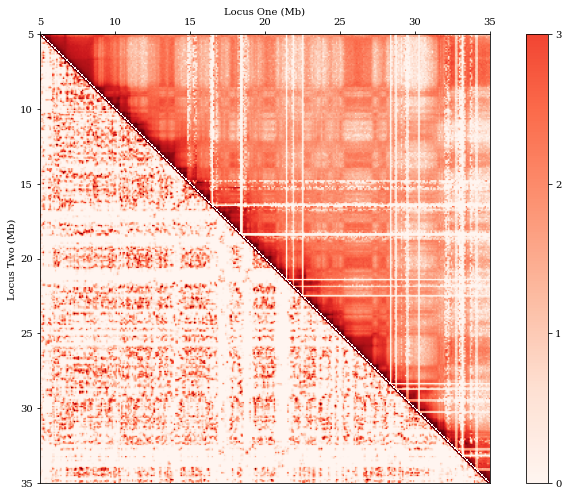

Correlation Coefficient: 0.317



Simulation: sim_56


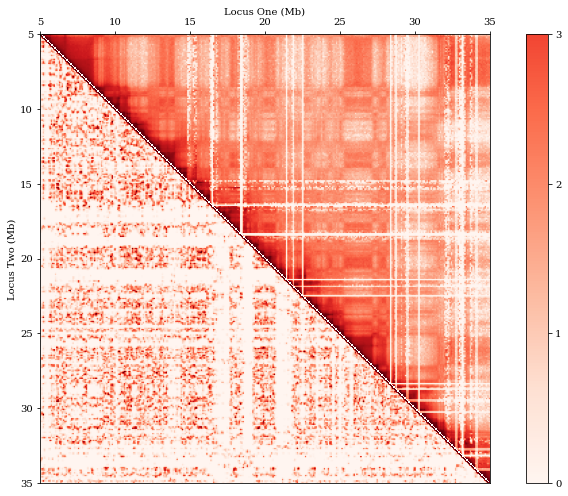

Correlation Coefficient: 0.317



Simulation: sim_57


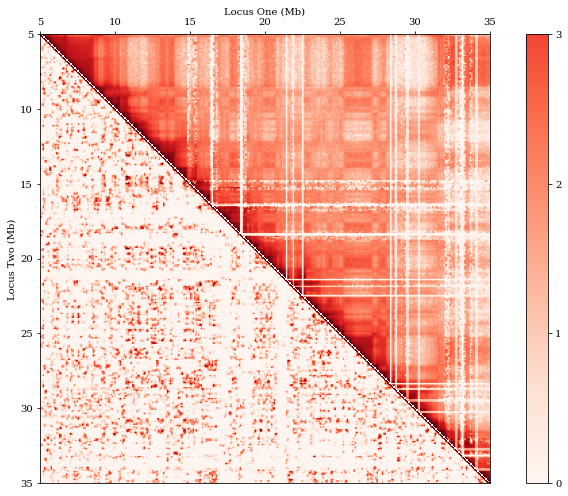

Correlation Coefficient: 0.298



Simulation: sim_58


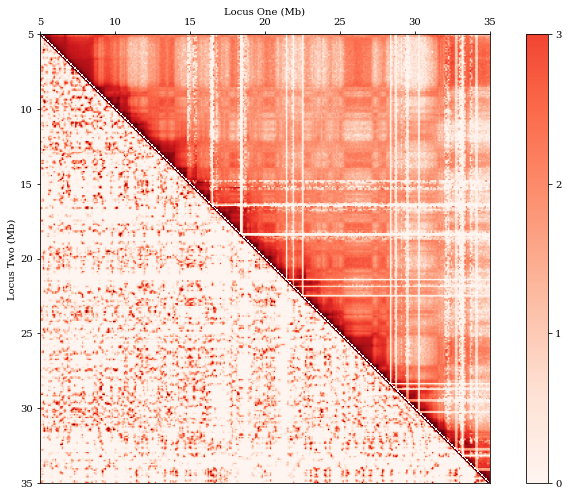

Correlation Coefficient: 0.303



Simulation: sim_59


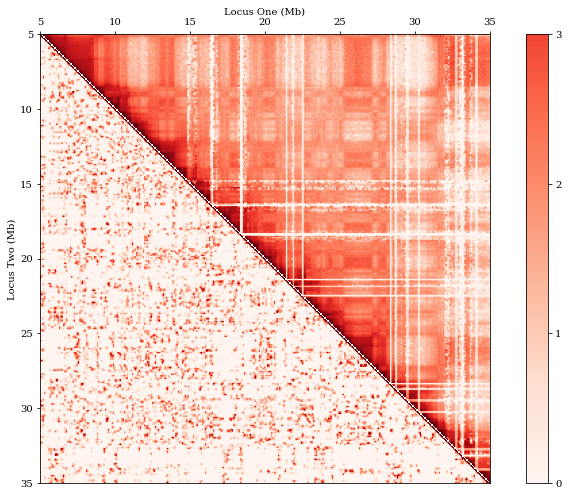

Correlation Coefficient: 0.299



Simulation: sim_60


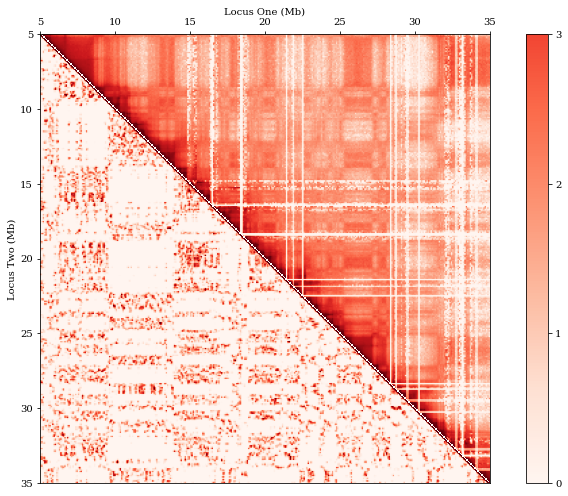

Correlation Coefficient: 0.291



Simulation: sim_61


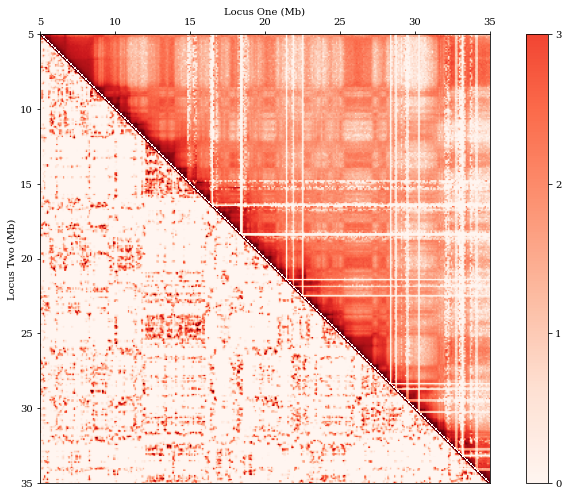

Correlation Coefficient: 0.308



Simulation: sim_62


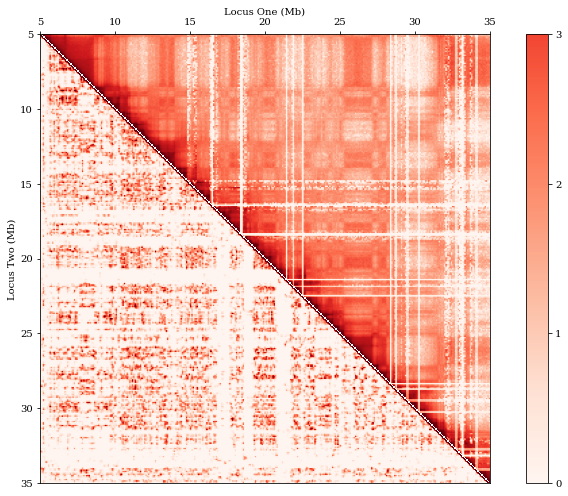

Correlation Coefficient: 0.322



Simulation: sim_63


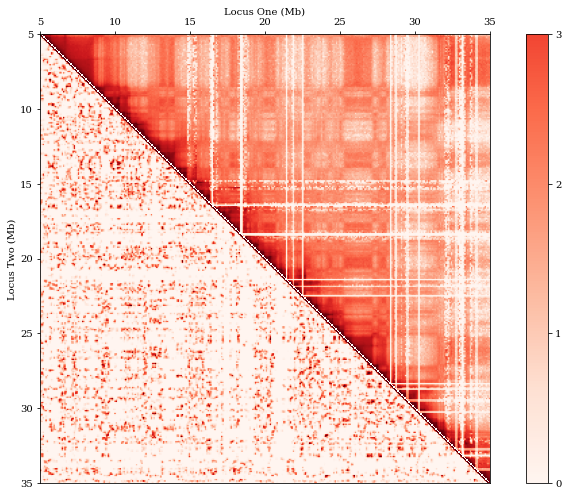

Correlation Coefficient: 0.304



Simulation: sim_64


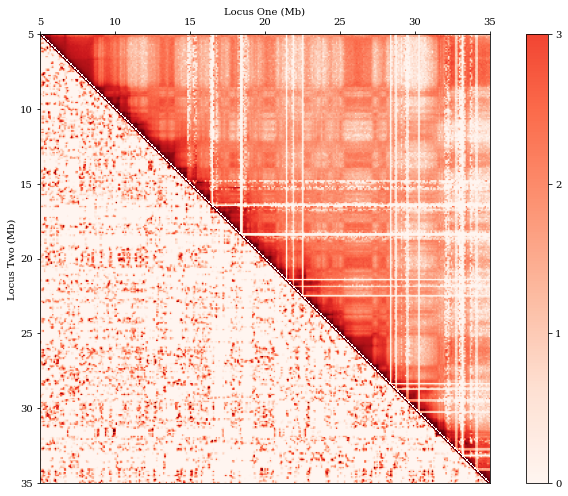

Correlation Coefficient: 0.294





In [9]:
correlation_coefficients = {}
max_scale = 5
for sim in sims:
    
    print(f"Simulation: {sim}")
    
    ref_cmap_upper = np.triu(ref_cmaps_rescaled[sim])
    ref_cmap_plot = ref_cmap_upper.copy()
    upper_percentile_signals = np.percentile(ref_cmaps_rescaled[sim], 99)
    ref_cmap_plot *= max_scale / upper_percentile_signals
    for i in range(len(ref_cmap_plot)):
        for j in range(i):
            ref_cmap_plot[i, j] = np.nan

    sim_cmap_lower = np.tril(sim_cmaps_rescaled[sim])
    sim_cmap_plot = sim_cmap_lower.copy()
    upper_percentile_signals = np.percentile(sim_cmaps_rescaled[sim], 99)
    sim_cmap_plot *= max_scale / upper_percentile_signals
    for i in range(len(sim_cmap_plot)):
        for j in range(i):
            sim_cmap_plot[j, i] = np.nan
            
    correlation_coefficient = np.corrcoef(ref_cmaps_rescaled[sim].flat, sim_cmaps_rescaled[sim].flat)[0, 1]
    correlation_coefficients[sim] = correlation_coefficient

    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.5)
    extents = [5, 35, 35, 5]
    im = ax.imshow(ref_cmap_plot, cmap="Reds", extent=extents, vmin=0, vmax=max_scale)
    im = ax.imshow(sim_cmap_plot, cmap="Reds", extent=extents, vmin=0, vmax=max_scale)
    ax.set_xticks([5, 10, 15, 20, 25, 30, 35])
    ax.set_yticks([5, 10, 15, 20, 25, 30, 35])
    ticks = np.arange(np.ceil(np.percentile(ref_cmaps_rescaled[sim], 99))+1)
    boundaries = np.linspace(0, np.ceil(np.percentile(ref_cmaps_rescaled[sim], 99)), 1000)
    ax.set_xlabel("Locus One (Mb)")
    ax.set_ylabel("Locus Two (Mb)")
    ax.xaxis.set_label_position("top")
    ax.xaxis.tick_top()
    fig.colorbar(im, cax=cax, orientation='vertical', ticks=ticks, boundaries=boundaries)
    plt.tight_layout()
    plt.show()
    print(f"Correlation Coefficient: {round(correlation_coefficient, 3)}")
    print("\n\n")

### Load Physical Parameters

In [10]:
cp_HP1 = {}
cp_PRC1 = {}
self_interact_HP1 = {}
self_interact_PRC1 = {}
cross_interact = {}

for sim in sims:
    df_binders = pd.read_csv(f"{output_dir}/{sim}/{binder_filename}", index_col="name")
    cp_HP1[sim] = df_binders.loc["HP1", "chemical_potential"]
    cp_PRC1[sim] = df_binders.loc["PRC1", "chemical_potential"]
    self_interact_HP1[sim] = df_binders.loc["HP1", "interaction_energy"]
    self_interact_PRC1[sim] = df_binders.loc["PRC1", "interaction_energy"]
    cross_interact[sim] = json.loads(df_binders.loc["HP1", "cross_talk_interaction_energy"].replace("'", "\""))["PRC1"]

### Print Correlation Coefficient Against Physical Parameter Settings

In [11]:
# `True` designates "high" parameter setting; `False` designates "low" parameter setting
print("Parameter Settings: ")
print("Reported in order: cross, CP_HP1, cp_PRC1, HP1-HP1, PRC1-PRC1")
for sim in sims:
    result = f"{cross_interact[sim] == cross_levels[1]}, {cp_HP1[sim] == cp_HP1_levels[1]}, {cp_PRC1[sim] == cp_PRC1_levels[1]}, {self_interact_HP1[sim] == HP1_self_levels[1]}, {self_interact_PRC1[sim] == PRC1_self_levels[1]}"
    result = result.replace("True", "+").replace("False", "-")
    print(result)

print("\n")
print("Correlation Coefficients: ")
for sim in sims:
    print(f"{correlation_coefficients[sim]}")

Parameter Settings: 
Reported in order: cross, CP_HP1, cp_PRC1, HP1-HP1, PRC1-PRC1
-, -, -, +, -
-, +, -, -, +
+, -, -, -, +
-, -, -, -, +
+, +, -, -, +
-, -, +, +, +
-, +, -, +, -
+, -, +, +, -
+, -, -, -, -
+, +, -, +, +
-, +, +, +, +
-, +, +, -, -
+, +, -, +, -
+, +, -, -, -
-, +, +, -, +
-, +, -, +, +
+, +, +, +, -
+, -, +, +, +
+, +, +, -, -
-, +, -, -, -
-, -, -, -, -
+, -, +, -, +
+, -, -, +, -
-, -, -, +, +
-, -, +, +, -
+, +, +, +, +
-, -, +, -, -
+, +, +, -, +
-, +, +, +, -
+, -, -, +, +
-, -, +, -, +
+, -, +, -, -


Correlation Coefficients: 
0.31263727947172293
0.29962156824885566
0.3117063841117226
0.3097583177991301
0.30837352851809857
0.30514340059040435
0.30716491443238836
0.296640834976959
0.29843061189709114
0.3139765443971826
0.2980459352711684
0.296367569035619
0.3012580853882438
0.2927402320149173
0.29341803711608194
0.3130510284576456
0.29832201257133045
0.311160909485594
0.3047060733881375
0.3000372946017025
0.29970629004107724
0.2981177968425489
0.31723928857731